In [27]:
using LinearAlgebra
#using MKL
using DelimitedFiles
using Plots;gr()
using LaTeXStrings

#Plots.default(show = true)
#pyplot()

include("generate_matrices2D.jl")
include("angmom.jl")

generate_spin_matrices (generic function with 1 method)

In [28]:
function Energyspectra(Lx::Int64, Ly::Int64, npts::Int64)
    #close("all")
    #t0=time()
    sigma_x, sigma_y, sigma_z = generate_spin_matrices(1/2)
    const_2D, CX2Dp, SX2Dp, CY2Dp, SY2Dp = generate_matrices_2D(Lx, Ly, 1, 1)
    const_2D, CX2Dnp, SX2Dnp, CY2Dnp, SY2Dnp = generate_matrices_2D(Lx, Ly, 0, 0)

    h_ci_np = zeros(ComplexF64,2*Lx*Ly,2*Lx*Ly)
    t0 = 1.0
    t1 = 1.0

    m_array = range(-4,4,npts)

    energies_np_array = zeros(npts*2*Lx*Ly)
    energies_p_array = zeros(npts*2*Lx*Ly)

    for ii = 1:npts
        h_ci_np = t1*(kron(SX2Dnp, sigma_x) + kron(SY2Dnp, sigma_y)) - t0 * kron(m_array[ii]*const_2D - CX2Dnp - CY2Dnp, sigma_z)
        h_ci_p = t1*(kron(SX2Dp, sigma_x) + kron(SY2Dp, sigma_y)) - t0 * kron(m_array[ii]*const_2D - CX2Dp - CY2Dp, sigma_z)

        energy_eigenvalues_np = eigvals(h_ci_np);
        energy_eigenvalues_p = eigvals(h_ci_p);
        for r=1:2*Lx*Ly
            energies_np_array[(ii-1)*(2*Lx*Ly) + r] = energy_eigenvalues_np[r];
            energies_p_array[(ii-1)*(2*Lx*Ly) + r] = energy_eigenvalues_p[r];
        end
    end
    xvar = kron(m_array, range(1,1,2*Lx*Ly))

    #t1 = time()
    #println("time taken = ", t1 - t0, "seconds")
    plt1 = scatter(xvar, energies_np_array, legend = false, xtickfontsize = 20, ytickfontsize = 20, legendfontsize = 20, markersize=0.2, xlabel=L"m", ylabel=L"E", framestyle = :box, linewidth=5, reuse=false, title="Allowed energies for OBC", titlefontsize=20)
    plt2 = scatter(xvar, energies_p_array, legend = false, xtickfontsize = 20, ytickfontsize = 20, legendfontsize = 20, markersize=0.2, xlabel=L"m", ylabel=L"E", framestyle = :box, linewidth=5, reuse=false, title="Allowed energies for PBC", titlefontsize=20)
    display(plt1)
    display(plt2)
end

Energyspectra (generic function with 1 method)

In [29]:
function BottIndexVsmHalfFilled(Lx::Int64, Ly::Int64)
    t0 = 1.0
    t1 = 1.0

    no_of_points=150

    m_array = range(-4,4,no_of_points)

    sigma_x, sigma_y, sigma_z = generate_spin_matrices(1/2)
    const_2D, CX2D, SX2D, CY2D, SY2D = generate_matrices_2D(Lx, Ly, 1, 1)

    xarray2D = kron(kron(range(1,1,Ly),range(1,Lx,Lx)), [1,1])
    yarray2D = kron(kron(range(1,Ly,Ly), range(1,1,Lx)), [1, 1])

    xmatrix2D = diagm(kron(kron(range(1,1,Ly),range(1,Lx,Lx)), [1,1]))
    ymatrix2D = diagm(kron(kron(range(1,Ly,Ly), range(1,1,Lx)), [1, 1]))

    U_x = diagm(exp.(2 * pi * im * xarray2D/Lx));
    V_y = diagm(exp.(2 * pi * im * yarray2D/Ly));

    bott_index_store = zeros(no_of_points)

    for a=1:no_of_points
        h_cip = t1 * (kron(SX2D, sigma_x) + kron(SY2D, sigma_y)) + t0 * kron(CX2D + CY2D - m_array[a] * const_2D, sigma_z);

        (energy_eigenvalues, eigenstates) = eigen(h_cip);

        filled_eigenstates = eigenstates[:,1:Lx*Ly]

        P = conj(filled_eigenstates) * transpose(filled_eigenstates)

        U = P * U_x * P + (kron(const_2D,[1 0;0 1]) - P);
        V = P * V_y * P + (kron(const_2D,[1 0;0 1]) - P);
        bott = U * V * U' * V'
        bott_index_store[a] = real((-im/(2*pi)) * sum(log.(eigvals(bott))))
    end

    plt1 = scatter(m_array, bott_index_store)
    display(plt1)
end

BottIndexVsmHalfFilled (generic function with 1 method)

In [39]:
function BottIndexVsChemicalPotentialRandomOnsitePeriodic(Lx::Int64, Ly::Int64, m_mass::Float64, disorderpotential::Float64)
    t0 = 1.0
    t1 = 1.0

    sigma_x, sigma_y, sigma_z = generate_spin_matrices(1/2)
    const_2D, CX2D, SX2D, CY2D, SY2D = generate_matrices_2D(Lx, Ly, 1, 1)

    xarray2D = kron(kron(range(1,1,Ly),range(1,Lx,Lx)), [1,1])
    yarray2D = kron(kron(range(1,Ly,Ly), range(1,1,Lx)), [1, 1])

    xmatrix2D = diagm(kron(kron(range(1,1,Ly),range(1,Lx,Lx)), [1,1]))
    ymatrix2D = diagm(kron(kron(range(1,Ly,Ly), range(1,1,Lx)), [1, 1]))

    U_x = diagm(exp.(2 * pi * im * xarray2D/Lx));
    V_y = diagm(exp.(2 * pi * im * yarray2D/Ly));

    bott_index_store = zeros(2*Lx*Ly)

    h_cip = t1 * (kron(SX2D, sigma_x) + kron(SY2D, sigma_y)) + t0 * kron(CX2D + CY2D - m_mass * const_2D, sigma_z);
    
    randarray = randn(Lx*Ly);
    zero_trace_randarray = randarray - (sum(randarray)/(Lx*Ly))*ones(Lx*Ly);
    disorderHamiltonian = disorderpotential * kron(diagm(zero_trace_randarray), [1 0; 0 1])

    h_total = h_cip + disorderHamiltonian

    (energy_eigenvalues, eigenstates) = eigen(h_total)

    for a=1:(2*Lx*Ly)
        filled_eigenstates = eigenstates[:,1:a]
        P = conj(eigenstates[:,1:a]) * transpose(eigenstates[:,1:a])

        U = P * U_x * P + (kron(const_2D,[1 0;0 1]) - P);
        V = P * V_y * P + (kron(const_2D,[1 0;0 1]) - P);
        bott = U * V * U' * V'
        bott_index_store[a] = real((-im/(2*pi)) * sum(log.(eigvals(bott))))
        #println("index = ",a, " mu = ",energy_eigenvalues[a], " C = ",bott_index_store[a])
    end

    plt1 = scatter(energy_eigenvalues, bott_index_store)
    plt1 = plot!(energy_eigenvalues, bott_index_store, xlabel=L"\mu", ylabel="Chern Number", framestyle=:box, title=string("disorder max = ", disorderpotential/t1, " m = ", m_mass),  legend=false ,reuse=true)
    display(plt1)
end

BottIndexVsChemicalPotentialRandomOnsitePeriodic (generic function with 1 method)

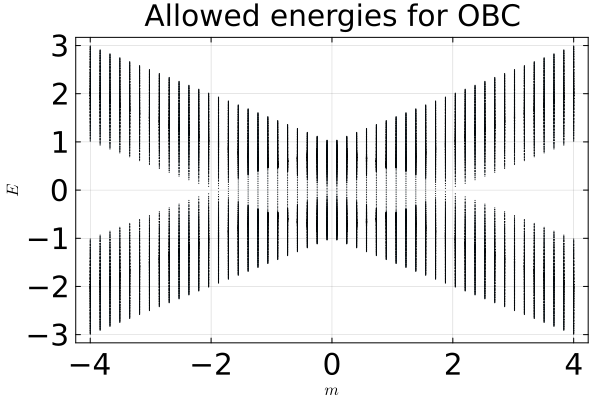

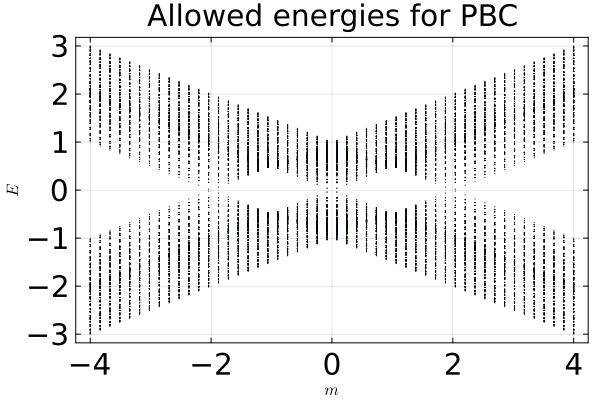

 18.140997 seconds (2.91 M allocations: 8.123 GiB, 7.06% gc time)


In [31]:
@time Energyspectra(20,20,50)

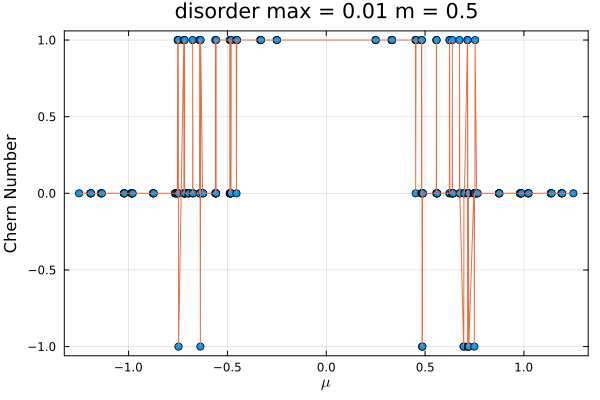

  4.037709 seconds (36.94 k allocations: 1.943 GiB, 0.33% gc time)


In [40]:
@time BottIndexVsChemicalPotentialRandomOnsitePeriodic(10, 10, 0.5, 0.01)